# <font color=green>deepBreaks Applications</font>
## Modeling spectral tuning sites of opsin proteins based on amino-acid sequence...  

# <font color=red>Step 0: mySQL DB Setup -</font> Script 0
## *The following text is a script written in mySQL format. You can copy and paste this directly into a mySQL text file or query window within mySQL workbench.*
```
DROP DATABASE vizphiz;
CREATE DATABASE vizphiz;
USE vizphiz;

CREATE TABLE lamdamax
(
id int unsigned not null primary key,
genus varchar(50),
species varchar(50),
celltype varchar(50),
cellsubtype varchar(50),
lamdamax decimal(9,5),
error decimal(9,5),
chromophore varchar(50),
method varchar(50),
stage varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE heterologous
(
hetid int unsigned not null primary key,
genus  varchar(50),
species varchar(50),
accession varchar(500),
mutations varchar(500),
lamdamax decimal(9,5),
error decimal(9,5),
cellculture varchar(50),
purification varchar(50),
spectrum varchar(50),
sourcetype varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE links
(
linkid int unsigned not null primary key,
accession varchar(500),
maxid int,
refid int,
evidence varchar(1000)
);

CREATE TABLE search
(
searchid int unsigned not null primary key,
researcher varchar(50),
month int,
year int,
engine varchar(500),
keywords varchar(500)
);

CREATE TABLE opsins
(
opsinid int unsigned not null primary key,
genefamily varchar(50),
genenames varchar(50),
genus varchar(50),
phylum varchar(25,)
species varchar(50),
db varchar(50),
accession varchar(500),
dna varchar(10000),
aa varchar(3333),
refid int
);

CREATE TABLE refs
(
refid int,
doilink varchar(100),
searchid int
);
``` 

In [206]:
#All neccessary packages to import for data process steps.
import mysql
import mysql.connector
#install mysql-connector-python // NOT mysql-connector
import re
import os
import datetime 
import subprocess

# <font color=red>STEP 0: Data Base Setup -</font> Script 1 - Import heterologous.tsv into mySQL


In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "Geass5566!!"
)

#read file for data
file1 = open('heterologous.tsv', 'r', encoding="utf8")
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")
    print(columns)
    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.heterologous (hetid, genus, species, accession, mutations, lamdamax, error, cellculture, purification, spectrum, sourcetype, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10], columns[11])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")

# <font color=red>STEP 0: Data Base Setup -</font> Script 2 - Import opsindb.tsv into mySQL

In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "Geass5566!!"
)

#read file for data
file1 = open('opsindb.tsv', 'r')
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")

    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.opsins (opsinid, genefamily, genenames, genus, species, phylum, db, accession, dna, aa, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")


# <font color=red>STEP 1: Extract Data From Vizphiz</font>
### Output = 8 different 'versions' // 'splits' of the data. 
2. Strategy = FFT-NS-2 // G-INS-1

In [213]:
inv = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
rod = re.compile('Rh[0-2]|exoRh')
d = re.compile("^NM_001014890.2$|^NM_001014890$")
iec = re.compile("Limenitis|Papilio")

In [234]:
#directory preperation
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
report_dir = str(f'vizphiz_data_splits_{dt_label}')
os.makedirs(report_dir)

wd_output = f'{report_dir}/wds.txt'
sws_output = f'{report_dir}/swd.txt'
mws_output = f'{report_dir}/mwd.txt'
rod_output = f'{report_dir}/rod.txt'
wd_ni_output = f'{report_dir}/wds_ni.txt'
inv_output = f'{report_dir}/inv_only.txt'
nmoc_output = f'{report_dir}/nmoc.txt'
mut_output = f'{report_dir}/mut_only.txt'
wh_metadata = f'{report_dir}/wds_meta.tsv'
sw_metadata = f'{report_dir}/sws_meta.tsv'
mw_metadata = f'{report_dir}/mws_meta.tsv'
rh_metadata = f'{report_dir}/rod_meta.tsv'
wd_ni_metadata = f'{report_dir}/wds_ni_meta.tsv'
inv_metadata = f'{report_dir}/inv_meta.tsv'
nmoc_metadata = f'{report_dir}/nmoc_meta.tsv'
mut_metadata = f'{report_dir}/mut_meta.txt'

meta_data_list = [wh_metadata,sw_metadata,mw_metadata,rh_metadata,wd_ni_metadata,inv_metadata,nmoc_metadata]

m = 0
s = 0
l = 0
r = 0
c = 0
z = 0
q = 0
mut = 0


In [235]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database="vizphiz",
  password="Geass5566!!"
) 
mycursor = mydb.cursor()

sql = "select DISTINCT o.genus,o.species,o.genefamily,o.accession,h.lamdamax,o.aa,o.phylum from opsins.opsins o, opsins.heterologous h WHERE (o.accession = h.accession AND o.refid = h.refid); "
mycursor.execute(sql)
myresult = mycursor.fetchall()


for x in myresult:       
#REG-DATA SECTION    
  with open(wd_output, 'a') as f:
    if m == 0:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    if (d.match(x[3])):
      pass
    else:
      m += 1 
      #This makes the fasta format file
      seq = ">S" + str(m)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(wd_ni_output, 'a') as f:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
      pass
    else:
      if c == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      c += 1 
      #This makes the fasta format file
      seq = ">S" + str(c)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(inv_output, 'a') as f:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or iec.match(x[0])):
      if q == 0:
        f.write(">Squid\nMGRDLRDNETWWYNPSIVVHPHWREFDQVPDAVYYSLGIFIGICGIIGCGGNGIVIYLFTKTKSLQTPANMFIINLAFSDFTFSLVNGFPLMTISCFLKKWIFGFAACKVYGFIGGIFGFMSIMTMAMISIDRYNVIGRPMAASKKMSHRRAFIMIIFVWLWSVLWAIGPIFGWGAYTLEGVLCNCSFDYISRDSTTRSNILCMFILGFFGPILIIFFCYFNIVMSVSNHEKEMAAMAKRLNAKELRKAQAGANAEMRLAKISIVIVSQFLLSWSPYAVVALLAQFGPLEWVTPYAAQLPVMFAKASAIHNPMIYSVSHPKFREAISQTFPWVLTCCQFDDKETEDDKDAETEIPAGESSDAAPSADAAQMKEMMAMMQKMQQQQAAYPPQGYAPPPQGYPPQGYPPQGYPPQGYPPQGYPPPPQGAPPQGAPPAAPPQGVDNQAYQA\n")
      q += 1 
      #This makes the fasta format file
      seq = ">S" + str(q)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)
    else:
      pass

  with open(nmoc_output, 'a') as f:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      pass
    else:
      if z == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      if(d.match(x[3])):
        pass
      else:
        z += 1 
        #This makes the fasta format file
        seq = ">S" + str(z)
        f.write(seq)
        seq2 = str('\n' + x[5] + '\n')
        f.write(seq2)

  with open(mut_output, 'a') as f:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      if mut == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      if(d.match(x[3])):
        pass
      else:
        mut += 1 
        #This makes the fasta format file
        seq = ">M" + str(mut)
        f.write(seq)
        seq2 = str('\n' + x[5] + '\n')
        f.write(seq2)
    else:
      pass

  with open(sws_output, 'a') as f:
    p = re.compile('^SWS|^UVS')
    if p.match(x[2]):
      s+=1
      if s == 1:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")  
    #This makes the fasta format file
      seq = ">S" + str(s)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(mws_output, 'a') as f:
    p = re.compile('^MWS|^LWS')
    if p.match(x[2]):
      l+=1
      if l == 1:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      #This makes the fasta format file
      seq = ">S" + str(l)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(rod_output, 'a') as f:
    p = re.compile('Rh[0-2]|exoRh')
    if p.match(x[2]):
      if r == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      if (inv.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
        pass
      else:
        r+=1
        #This makes the fasta format file
        seq = ">S" + str(r)
        f.write(seq)
        seq2 = str('\n' + x[5] + '\n')
        f.write(seq2)

#METADATA SECTION
  with open(wh_metadata, 'a') as g:
    if m == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
      g.write("Bovine\t500.0000\tBos_tarus\tRh1\tNM_001014890\n")
    if (d.match(x[3])):
      pass
    else:        
      md =  str("S" + str(m) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(wd_ni_metadata, 'a') as g:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
      pass
    else:
      if c == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_tarus\tRh1\tNM_001014890\n")

      md =  str("S" + str(c) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(inv_metadata, 'a') as g:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or iec.match(x[0])):
      if q == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Squid\t473.0000\tTodarodes_pacificus\tRh1\tX70498\n")

      md =  str("S" + str(q) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)
    else:
      pass
        
  with open(sw_metadata, 'a') as g:
  #This makes the metadata formatted for a linear regression model.
    p = re.compile('^SWS|^UVS')
    if p.match(x[2]):
      if s == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
      md =  str("S" + str(s) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(mw_metadata, 'a') as g:
    #This makes the metadata formatted for a linear regression model.
    p = re.compile('^MWS|^LWS')
    if p.match(x[2]):
      if l == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
      md =  str("S" + str(l) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(rh_metadata, 'a') as g:
    #This makes the metadata formatted for a linear regression model.
    p = re.compile('Rh[0-3]|exoRh')

    if p.match(x[2]):
      if r == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
      if (inv.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
        pass
      else:  
        md =  str("S" + str(r) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
        g.write(md)

  with open(nmoc_metadata, 'a') as g:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      pass
    else:
      if z == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
      if(d.match(x[3])):
        pass
      else:        
        md =  str("S" + str(z) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
        g.write(md)

  with open(mut_metadata, 'a') as g:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      if mut == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
      if(d.match(x[3])):
        pass
      else:        
        md =  str("M" + str(mut) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
        g.write(md)
    else:
      pass

In [236]:
msp_erg_raw = open('./msp_test_data/msp_erg_raw.txt').readlines()
for lines in msp_erg_raw:
  with open(wd_output, 'a') as f:
    f.write(lines)
  with open(wd_ni_output, 'a') as f:
    f.write(lines)
  with open(rod_output, 'a') as f:
    f.write(lines)
  with open(nmoc_output, 'a') as f:
    f.write(lines)
  with open(inv_output, 'a') as f:
    f.write(lines)
  with open(mws_output, 'a') as f:
    f.write(lines)
  with open(sws_output, 'a') as f:
    f.write(lines)


In [238]:
mut_only = open(mut_output).readlines()
x = 0
for lines in mut_only:
  if x <= 1:
    if x == 0:
      with open(nmoc_output, 'a') as m:
        m.write('\n')
    else:
      pass
    x+=1
  else:
    with open(nmoc_output, 'a') as m:
      m.write(lines)

# <font color=red>STEP 2: Align Raw Data and Format for 'deepBreaks'</font>
## REMINDER - You will need to change the directory for the 'mafft_exe' variable to the one of your own operating system!


In [239]:
from Bio.Align.Applications import MafftCommandline
from Bio import AlignIO

data_split_list = [wd_output,sws_output,mws_output,rod_output,wd_ni_output,inv_output,nmoc_output]
output_list = []
mafft_exe = 'C:/Users/safra/mafft-win/mafft.bat' 

for data in data_split_list:
    output = f'{data.split(".")[0]}_aligned.txt'
    mafft_cline = MafftCommandline(mafft_exe, input=f'./{data}')
    #print(mafft_cline)
    stdout, stderr = mafft_cline()

    with open(output, "w") as handle:
        handle.write(stdout)
        #print(handle)
    align = AlignIO.read(output, "fasta")
    output_list.append(f'{output}')


C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-08-07_11-13-00/wds.txt
<_io.TextIOWrapper name='vizphiz_data_splits_2023-08-07_11-13-00/wds_aligned.txt' mode='w' encoding='UTF-8'>
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-08-07_11-13-00/swd.txt
<_io.TextIOWrapper name='vizphiz_data_splits_2023-08-07_11-13-00/swd_aligned.txt' mode='w' encoding='UTF-8'>
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-08-07_11-13-00/mwd.txt
<_io.TextIOWrapper name='vizphiz_data_splits_2023-08-07_11-13-00/mwd_aligned.txt' mode='w' encoding='UTF-8'>
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-08-07_11-13-00/rod.txt
<_io.TextIOWrapper name='vizphiz_data_splits_2023-08-07_11-13-00/rod_aligned.txt' mode='w' encoding='UTF-8'>
C:/Users/safra/mafft-win/mafft.bat ./vizphiz_data_splits_2023-08-07_11-13-00/wds_ni.txt
<_io.TextIOWrapper name='vizphiz_data_splits_2023-08-07_11-13-00/wds_ni_aligned.txt' mode='w' encoding='UTF-8'>
C:/Users/safra/mafft-win

In [240]:
print(output_list)

for item in output_list:
    output = item.split('.')[0]
    print(output)

['vizphiz_data_splits_2023-08-07_11-13-00/wds_aligned.txt', 'vizphiz_data_splits_2023-08-07_11-13-00/swd_aligned.txt', 'vizphiz_data_splits_2023-08-07_11-13-00/mwd_aligned.txt', 'vizphiz_data_splits_2023-08-07_11-13-00/rod_aligned.txt', 'vizphiz_data_splits_2023-08-07_11-13-00/wds_ni_aligned.txt', 'vizphiz_data_splits_2023-08-07_11-13-00/inv_only_aligned.txt', 'vizphiz_data_splits_2023-08-07_11-13-00/nmoc_aligned.txt']
vizphiz_data_splits_2023-08-07_11-13-00/wds_aligned
vizphiz_data_splits_2023-08-07_11-13-00/swd_aligned
vizphiz_data_splits_2023-08-07_11-13-00/mwd_aligned
vizphiz_data_splits_2023-08-07_11-13-00/rod_aligned
vizphiz_data_splits_2023-08-07_11-13-00/wds_ni_aligned
vizphiz_data_splits_2023-08-07_11-13-00/inv_only_aligned
vizphiz_data_splits_2023-08-07_11-13-00/nmoc_aligned


In [241]:
#enter list of aligned text files here.
inputs = output_list
deep_breaks_input_data = []
# inputs = ['wds_aligned.txt','wds_ni_aligned.txt','rod_aligned.txt','nmoc_aligned.txt']
##enter list of names for desired formatted fasta files here.
# output = ['wds_fmt.fasta','wds_ni_fmt.fasta','rod_fmt.fasta','nmoc_fmt.fasta']
i=0
k = 0
for item in inputs:
    print(item)
    lines = open(inputs[i]).readlines()
    output = f'./{inputs[i].split(".")[0]}_db_fmt.fasta'
    deep_breaks_input_data.append(output)
    print(output)
    file = open(output, 'w')
    m=0
    for line in lines:
        snip = str(lines[k])
        if '>' in snip:
            if m == 0:
                m+=1
            else:
                file.write("\n")
            file.write(snip)
        else:
            entry = ""
            entry = str(snip.replace("\n",""))
            file.write(entry)
        k+=1
    k = 0
    i+=1
    file.close()

vizphiz_data_splits_2023-08-07_11-13-00/wds_aligned.txt
./vizphiz_data_splits_2023-08-07_11-13-00/wds_aligned_db_fmt.fasta
vizphiz_data_splits_2023-08-07_11-13-00/swd_aligned.txt
./vizphiz_data_splits_2023-08-07_11-13-00/swd_aligned_db_fmt.fasta
vizphiz_data_splits_2023-08-07_11-13-00/mwd_aligned.txt
./vizphiz_data_splits_2023-08-07_11-13-00/mwd_aligned_db_fmt.fasta
vizphiz_data_splits_2023-08-07_11-13-00/rod_aligned.txt
./vizphiz_data_splits_2023-08-07_11-13-00/rod_aligned_db_fmt.fasta
vizphiz_data_splits_2023-08-07_11-13-00/wds_ni_aligned.txt
./vizphiz_data_splits_2023-08-07_11-13-00/wds_ni_aligned_db_fmt.fasta
vizphiz_data_splits_2023-08-07_11-13-00/inv_only_aligned.txt
./vizphiz_data_splits_2023-08-07_11-13-00/inv_only_aligned_db_fmt.fasta
vizphiz_data_splits_2023-08-07_11-13-00/nmoc_aligned.txt
./vizphiz_data_splits_2023-08-07_11-13-00/nmoc_aligned_db_fmt.fasta


In [242]:
print(deep_breaks_input_data)

['./vizphiz_data_splits_2023-08-07_11-13-00/wds_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-08-07_11-13-00/swd_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-08-07_11-13-00/mwd_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-08-07_11-13-00/rod_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-08-07_11-13-00/wds_ni_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-08-07_11-13-00/inv_only_aligned_db_fmt.fasta', './vizphiz_data_splits_2023-08-07_11-13-00/nmoc_aligned_db_fmt.fasta']


# <font color=red>STEP 3: deepBreaks</font>
## THIS IS A LONG SECTION! 
### STEP 4 doesn't start until Cell 34

In [38]:
# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
from deepBreaks.preprocessing import write_fasta
import warnings
import datetime
import os
import shutil 

In [39]:
warnings.filterwarnings("ignore")
warnings.simplefilter('ignore')

In [40]:
# defining user params, file pathes, analysis type

# path to sequences
seqFileName = rf'wds_aligned_db_fmt_mutant_aligned.fasta' 
#find way to automatically save aligned file to report directory and then have unaligned sequence align to file via mafft wapper and thennn run the hot-encode step to query model on correctly formatted seq.
# path to metadata
metaDataFileName = 'wds_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 


In [41]:
# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
#seqFile = seqFileName.split('/')[2]
#print(seqFile)
seqFile = seqFileName.split('.')[0]
#print(seqFile)
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

direcory preparation


In [42]:
%%time
print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)
# importing sequences data
print('reading fasta file')

tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)
msp = tr.copy()

shutil.copy2(f'{seqFileName}',report_dir)
write_fasta(dat = tr, fasta_file = f'{seqFile}_gap_dropped.fasta' , report_dir = report_dir)
tr.to_csv(path_or_buf= f'{report_dir}/col_check.csv',mode="w")


reading meta-data
reading fasta file
wds_aligned_db_fmt_mutant_aligned_gap_dropped.fasta was saved successfully
CPU times: total: 500 ms
Wall time: 509 ms


In [158]:
#start here with removing the bottom ~25 sequences 
#msp = tr.iloc[856:].copy()

In [43]:
tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

(856, 356)

In [44]:
tr.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p347,p348,p349,p350,p351,p352,p353,p354,p355,Lambda_Max
Bovine,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,T,S,Q,V,A,P,A,500.0
S1,M,N,G,T,E,G,P,Y,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,502.0
S2,NaN,NaN,NaN,T,E,G,P,Y,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,502.0
S3,NaN,NaN,NaN,T,E,G,P,D,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,481.0
S4,NaN,NaN,NaN,T,E,G,P,F,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,494.0


In [45]:
sv_msp = tr.shape[0]
print(sv_msp)

856


In [19]:
mut = msp.iloc[sv_msp+35:].copy()
mut.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355


In [46]:
msp = msp.iloc[sv_msp:].copy()
msp.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
Neogonodactylus_oerstedii|334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Neogonodactylus_oerstedii|383,NaN,NaN,NaN,NaN,D,W,E,N,V,G,...,NaN,NaN,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Bombus_impatiens|539,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,D,NaN,N,E,K,S,N,A,NaN,NaN
Bombus_impatiens|424,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,T,E,K,I,K,S,D,D
Bombus_impatiens|347,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,P,A,A,S,S,NaN,NaN,NaN


In [47]:
msp.shape

(70, 355)

In [259]:
#msp_meta_data = read_data('./msp_test_data/erg_msp_meta.tsv', seq_type = None, is_main=False)
#msp.merge(msp_meta_data.loc[:, mt],  left_index=True, right_index=True)
#msp.shape

(581, 349)

In [49]:
import numpy as np
import csv
import pandas as pd

In [50]:
sample_n = 100
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1


In [51]:
unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)


In [52]:
base_test = meta_data.loc[drop_indices].copy()
base_test.head()

,Lambda_Max,Species,Opsin_Family,Accession
S472,447.0,Oryzias_luzonensis,Rh2,LC260048
S397,419.0,Gallus_gallus,SWS1,NM_205438.1_V116L
S12,498.0,Altolamprologus_calvus,Rh1,AB458132.1
S32,498.0,Pseudotropheus_sp.,Rh1,GQ422475.1
S168,467.0,Gekko_gekko,Rh2,M92035_A164S


In [53]:
y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)

Shape of data is:  (756, 355)


In [54]:
bovine = tr.loc['Bovine'].copy()

#print(bovine)

bovine.to_csv(path_or_buf= f'{report_dir}/bovine.csv',index = True,mode="w")

In [55]:
unseen.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
S472,NaN,N,G,T,E,G,K,N,F,Y,...,T,A,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
S397,M,S,NaN,S,D,NaN,D,D,F,Y,...,S,V,S,S,S,Q,V,G,P,T
S12,M,N,G,T,E,G,P,F,F,Y,...,S,V,S,S,S,S,V,S,P,A
S32,M,N,G,T,E,G,P,F,F,Y,...,S,V,S,S,S,S,V,S,P,A
S168,M,N,G,T,E,G,I,N,F,Y,...,S,V,S,S,S,Q,V,A,P,A


**Attention**: metadata and sequences data should have the names as their row names and for each sequence their must be a value in the meta data file.

In [56]:
print('metadata looks like this:')
meta_data.head()

metadata looks like this:


,Lambda_Max,Species,Opsin_Family,Accession
Bovine,500.0,Bos_tarus.0000,Rh1,NM_001014890
S1,502.0,Neoniphon_sammara,Rh1,U57536.1
S2,502.0,Neoniphon_argenteus,Rh1,U57540.1
S3,481.0,Neoniphon_aurolineatus,Rh1,U57541.1
S4,494.0,Sargocentron_punctatissimum,Rh1,U57543.1


In [57]:
print('sequence data looks like this:')
tr.head()

sequence data looks like this:


,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
Bovine,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,NaN,T,S,Q,V,A,P,A
S1,M,N,G,T,E,G,P,Y,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S2,NaN,NaN,NaN,T,E,G,P,Y,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S3,NaN,NaN,NaN,T,E,G,P,D,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S4,NaN,NaN,NaN,T,E,G,P,F,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A


### Preprocessing
In this step, we do all these steps:
1. dropping columns with a number of missing values above a certain threshold  
2. dropping zero entropy columns  
3. imputing missing values with the mode of that column  
4. replacing cases with a frequency below a threshold (default 1.5%) with the mode of that column
5. dropping zero entropy columns
6. use statistical tests (each position against the phenotype) and drop columns with p-values below a threshold (default 0.25)
7. one-hot encode the remaining columns
8. calculate the pair-wise distance matrix for all of the columns
9. use the distance matrix for DBSCAN and cluster the correlated positions together
10. keep only one column (closes to center of each cluster) for each group and drop the rest from the training data set

In [58]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=False)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=False))
    ])

In [59]:
%%time
report, top = model_compare_cv(X=tr, y=y, preprocess_pipe=prep_pipeline,
                               models_dict=get_models(ana_type=ana_type),
                               scoring=get_scores(ana_type=ana_type),
                               report_dir=report_dir,
                               cv=12, ana_type=ana_type, cache_dir=report_dir)

Fitting rf...


Fitting Adaboost...
Fitting et...
Fitting gbc...
Fitting dt...
Fitting lr...
Fitting Lasso...
Fitting LassoLars...
Fitting BayesianRidge...
Fitting HubR...
Fitting lgbm...
Fitting xgb...
CPU times: total: 8.39 s
Wall time: 1min 47s


MAE = Mean Absolute Error

MSE = Mean Squared Error

RMSE = Rooted Mean Square Error

MAPE = Mean Absolute % Error - the average magnitude of error produced by a model, or how far off predictions are on average. A MAPE value of 20% means that the average absolute percentage difference between the predictions and the actuals is 20%

In [60]:
report

,R2,MAE,MSE,RMSE,MAPE
lgbm,9.296213e-01,7.702184e+00,2.623180e+02,1.524600e+01,1.755932e-02
BayesianRidge,9.293590e-01,8.514395e+00,2.616985e+02,1.539922e+01,1.947317e-02
gbc,9.132503e-01,8.715888e+00,3.199033e+02,1.666524e+01,1.975524e-02
HubR,9.112103e-01,9.708325e+00,3.260808e+02,1.741357e+01,2.186571e-02
rf,9.082348e-01,7.932628e+00,3.363718e+02,1.697738e+01,1.804944e-02
xgb,9.038639e-01,7.792160e+00,3.528317e+02,1.727263e+01,1.773913e-02
LassoLars,8.845814e-01,1.399628e+01,4.164216e+02,2.012687e+01,3.154787e-02
Lasso,8.845698e-01,1.399696e+01,4.164608e+02,2.012779e+01,3.154945e-02
et,8.802647e-01,8.706933e+00,4.374580e+02,1.925295e+01,1.986620e-02
dt,8.711750e-01,9.114949e+00,4.699257e+02,2.014208e+01,2.072448e-02


In [61]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=True)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=True))
    ])

In [62]:
modified_top = []
for model in top:
    modified_top.append(make_pipeline(steps=[('prep', prep_pipeline), model.steps[-1]]))

In [63]:
top_model_list = []
for mod_nm in top:
    my_top_models = str(mod_nm[1:])
    my_top_models = my_top_models.split("'")[1]
    top_model_list.append(my_top_models)
    #print(my_top_models)

In [64]:
modified_top[0]

Pipeline(steps=[('prep',
                 Pipeline(steps=[('mc', MisCare(missing_threshold=0.05)),
                                 ('cc', ConstantCare()),
                                 ('ur', URareCare(threshold=0.025)),
                                 ('cc2', ConstantCare()),
                                 ('one_hot', CustomOneHotEncoder()),
                                 ('feature_selection',
                                  FeatureSelection(alpha=0.1, keep=True,
                                                   model_type='reg')),
                                 ('collinear_care',
                                  CollinearCare(dist_method='correlation',
                                                keep=True, threshold=0.05))])),
                ('lgbm', LGBMRegressor(random_state=123))])

In [65]:
%%time
top = finalize_top(X=tr, y=y, top_models=modified_top, grid_param=get_params(),report_dir=report_dir, cv=10)


Tuning lgbm...


Tuning BayesianRidge...
Tuning gbc...
CPU times: total: 18.6 s
Wall time: 2min 51s


In [66]:
%%time
sr = summarize_results(top_models=top, report_dir=report_dir)

CPU times: total: 1.28 s
Wall time: 1.27 s


In [67]:
sr.head()

,feature,p_value,score,lgbm,BayesianRidge,gbc,mean
0,p1_GAP,2.499279e-05,17.988063,0.000000,0.008707,0.000238,0.002982
1,p1_L,5.095573e-17,73.731546,0.000000,0.033742,0.000000,0.011247
2,p1_M,3.471800e-30,142.372063,0.015385,0.006654,0.000000,0.007346
3,p1_Q,1.300664e-03,10.419776,0.061538,0.030287,0.000000,0.030609
4,p2_DQLMTGPHWY,3.596028e-11,45.151359,0.046154,0.266821,0.074180,0.129052


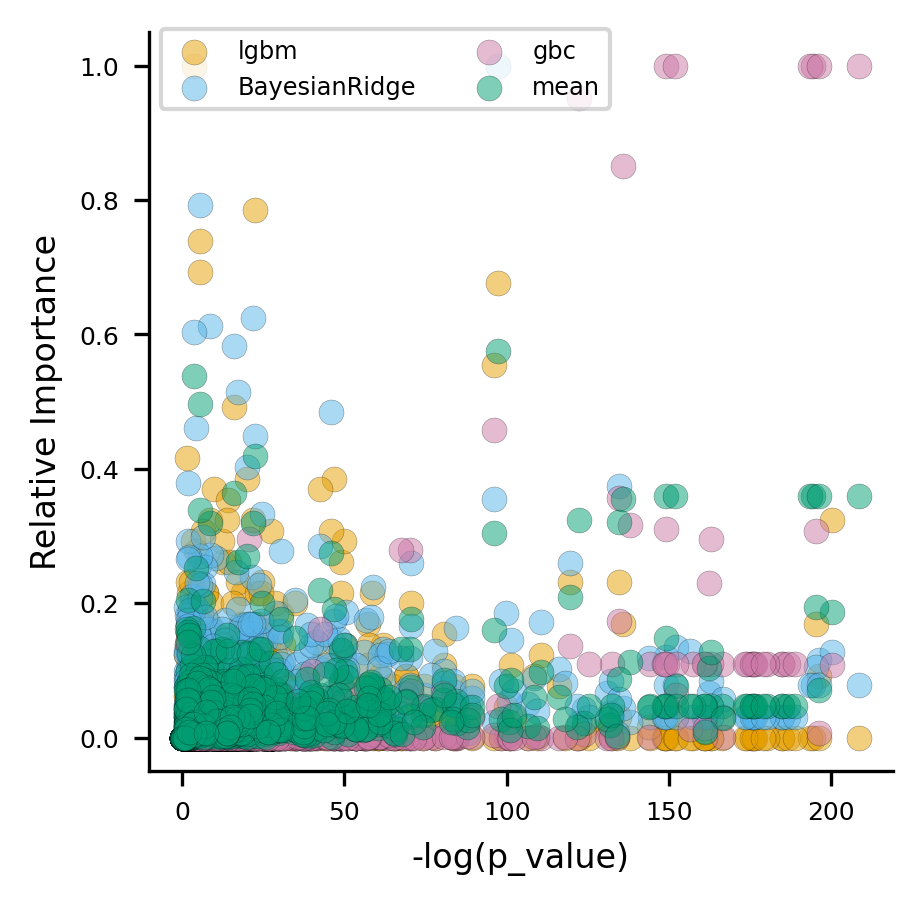

In [68]:
scatter_plot = plot_scatter(summary_result=sr, report_dir=report_dir)

In [69]:
%%time
mean_imp = mean_importance(top, report_dir=report_dir)

CPU times: total: 172 ms
Wall time: 153 ms


mean Done


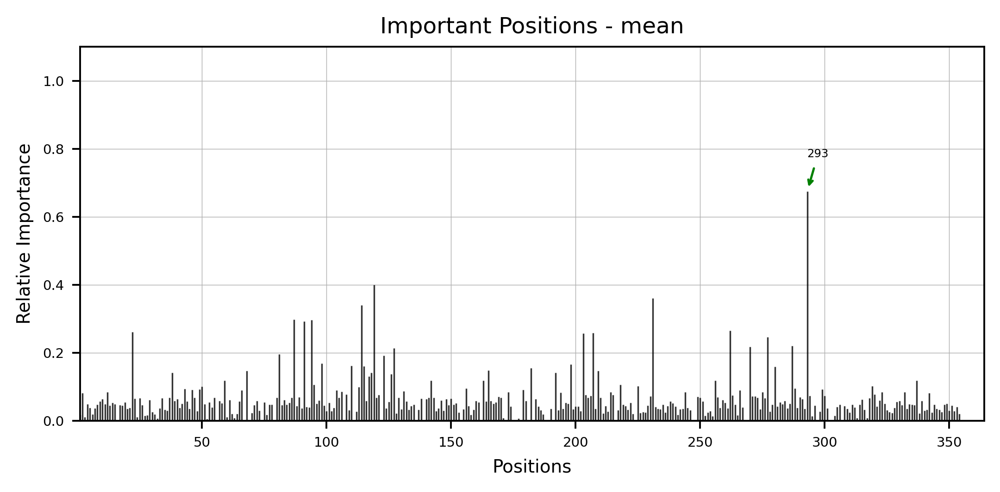

In [70]:
dp_plot(importance=mean_imp,imp_col='mean', model_name='mean', report_dir=report_dir)

In [71]:
tr = prep_pipeline[:4].fit_transform(tr)

lgbm Done
lgbm  Done
BayesianRidge Done
BayesianRidge  Done
gbc Done
gbc  Done


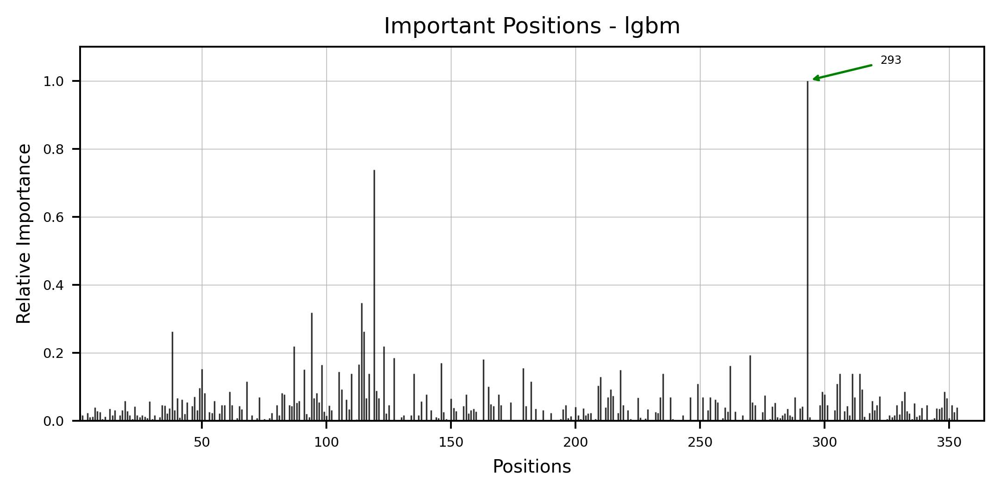

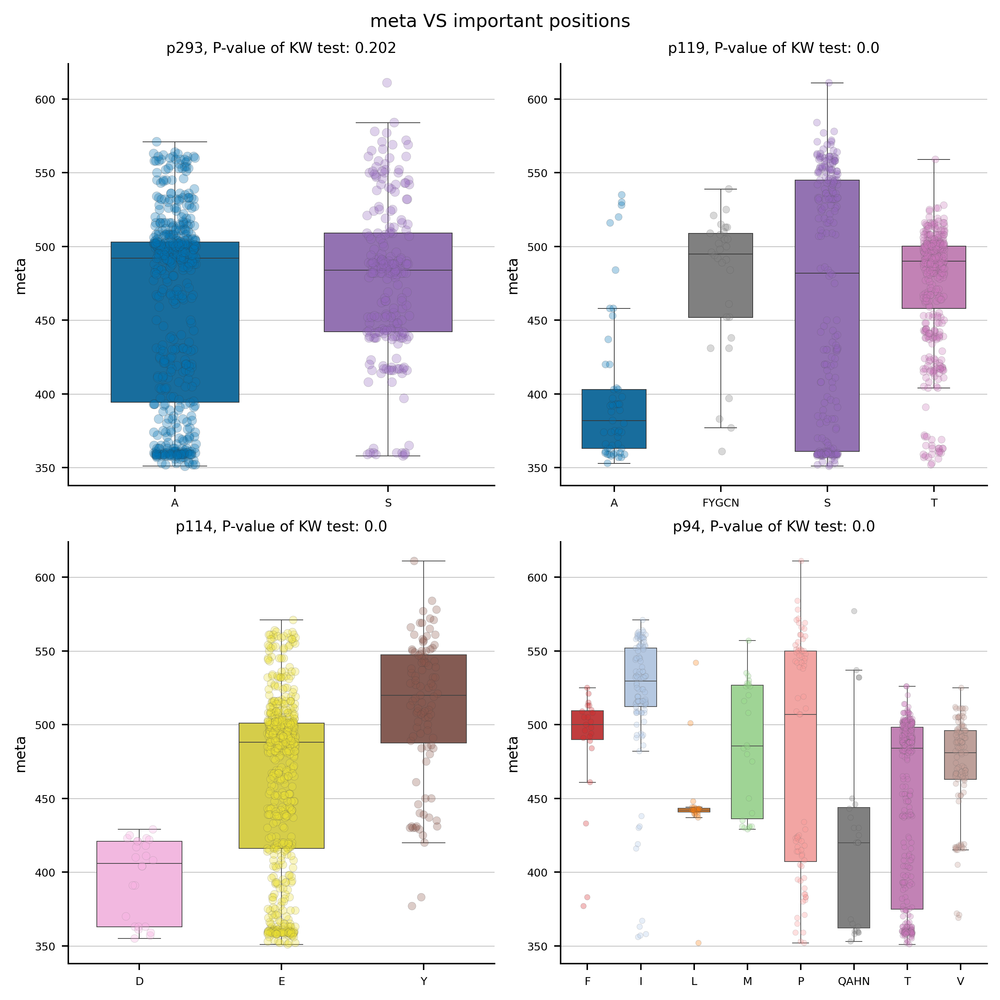

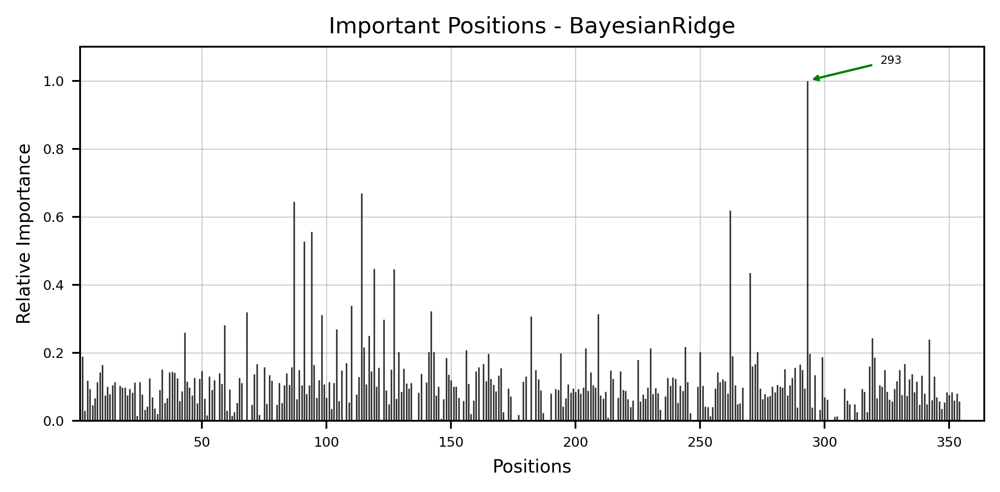

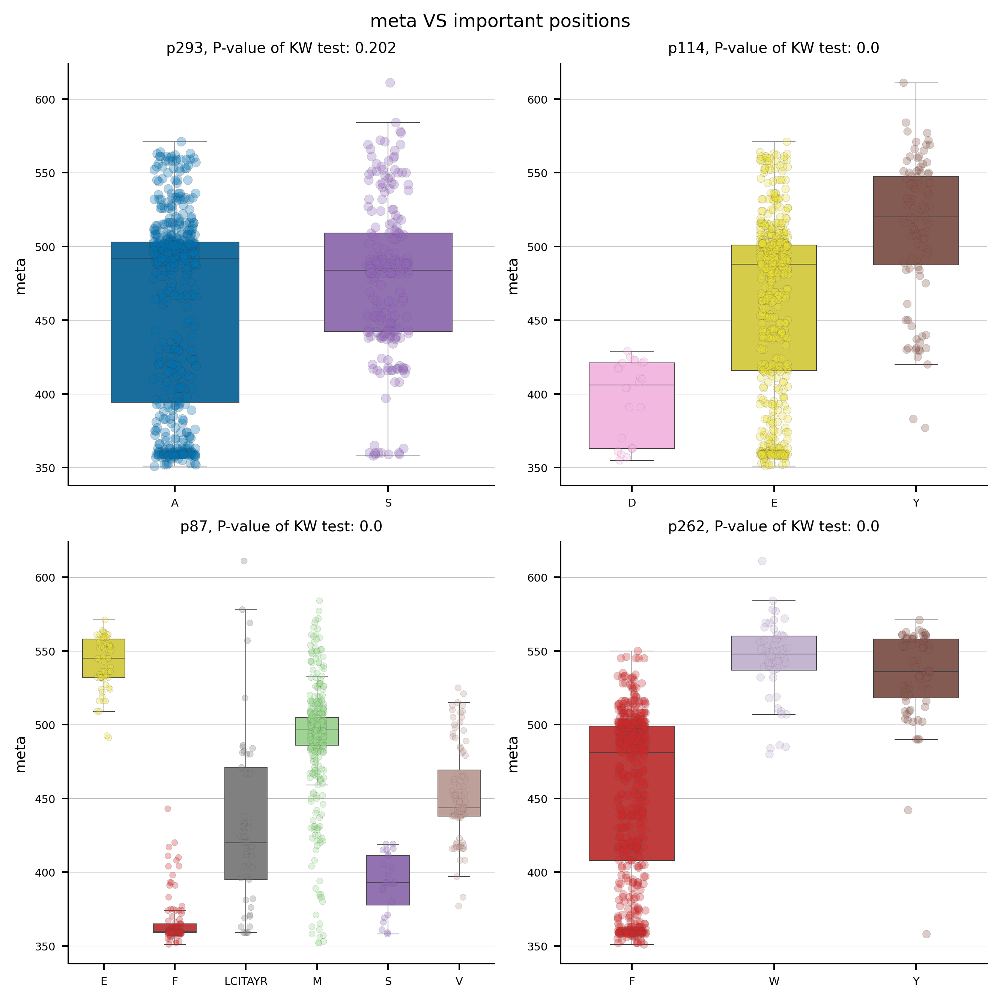

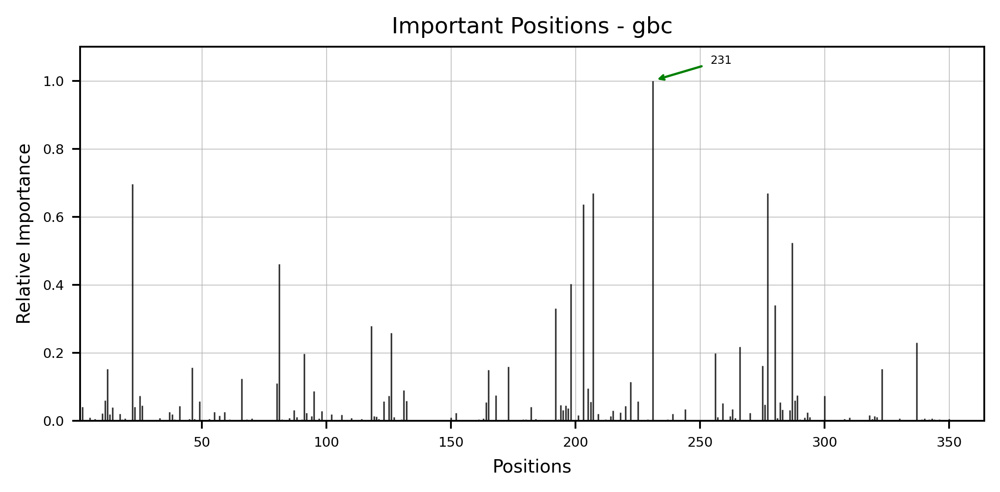

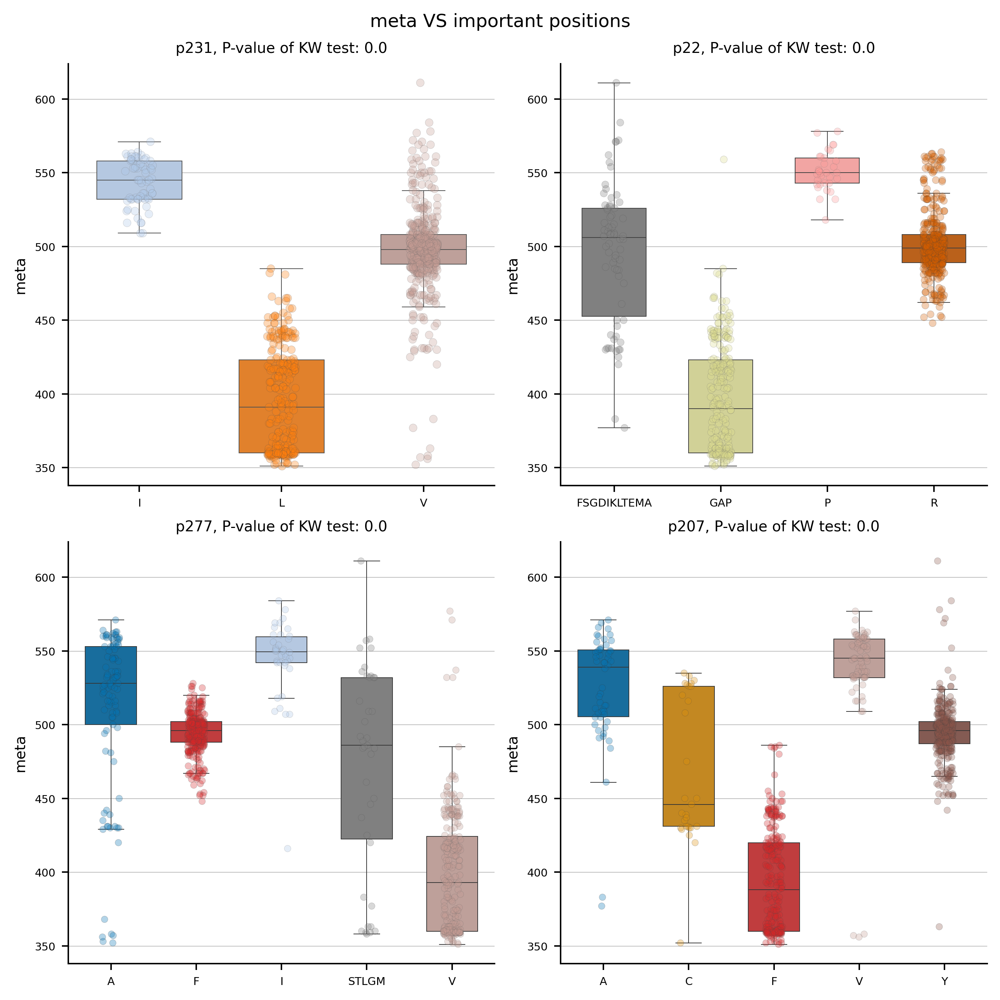

In [72]:
for model in top:
    model_name = model.steps[-1][0]
    dp_plot(importance=importance_from_pipe(model),
            imp_col='standard_value',
            model_name = model_name, report_dir=report_dir)
    
    plot_imp_model(importance=importance_from_pipe(model), 
               X_train=tr, y_train=y, model_name=model_name,
                   meta_var='meta', model_type=ana_type, report_dir=report_dir)

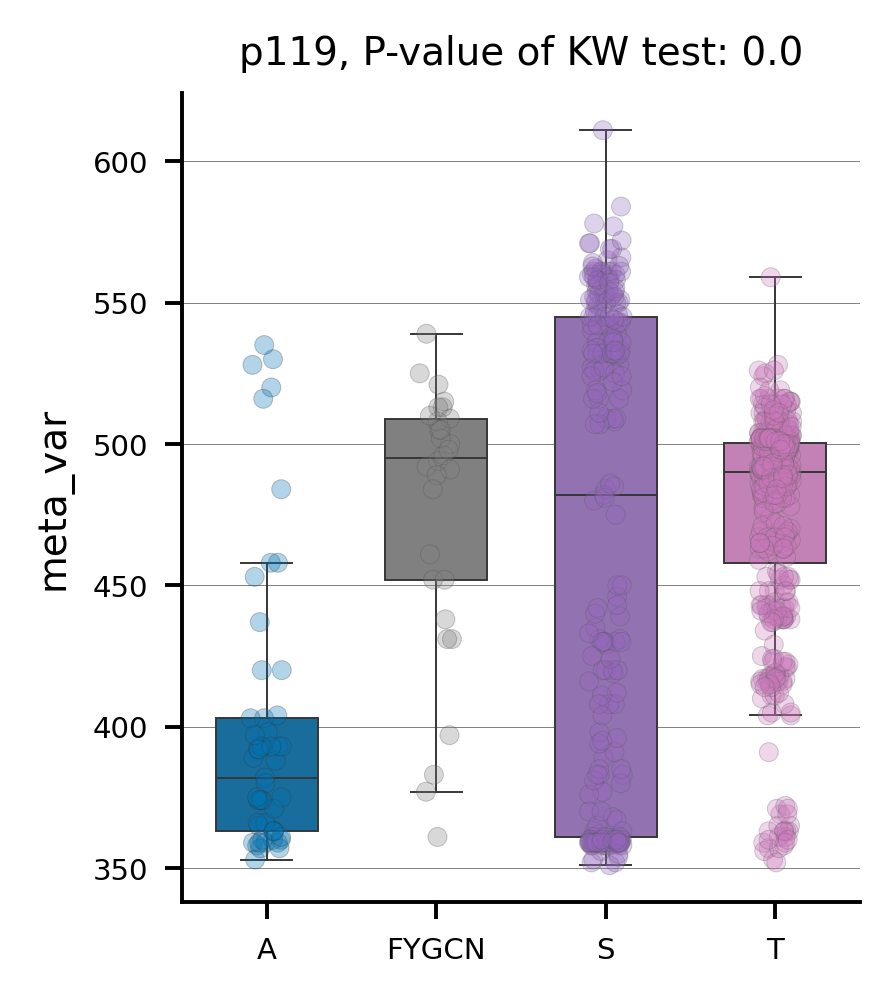

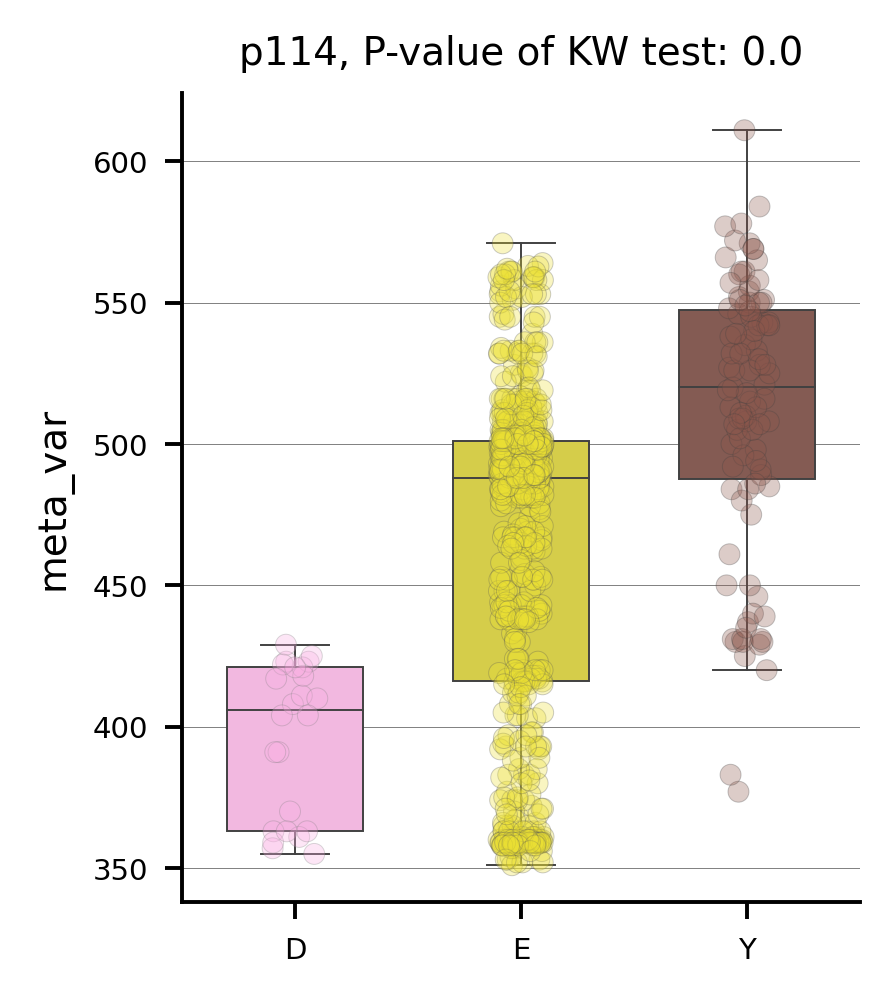

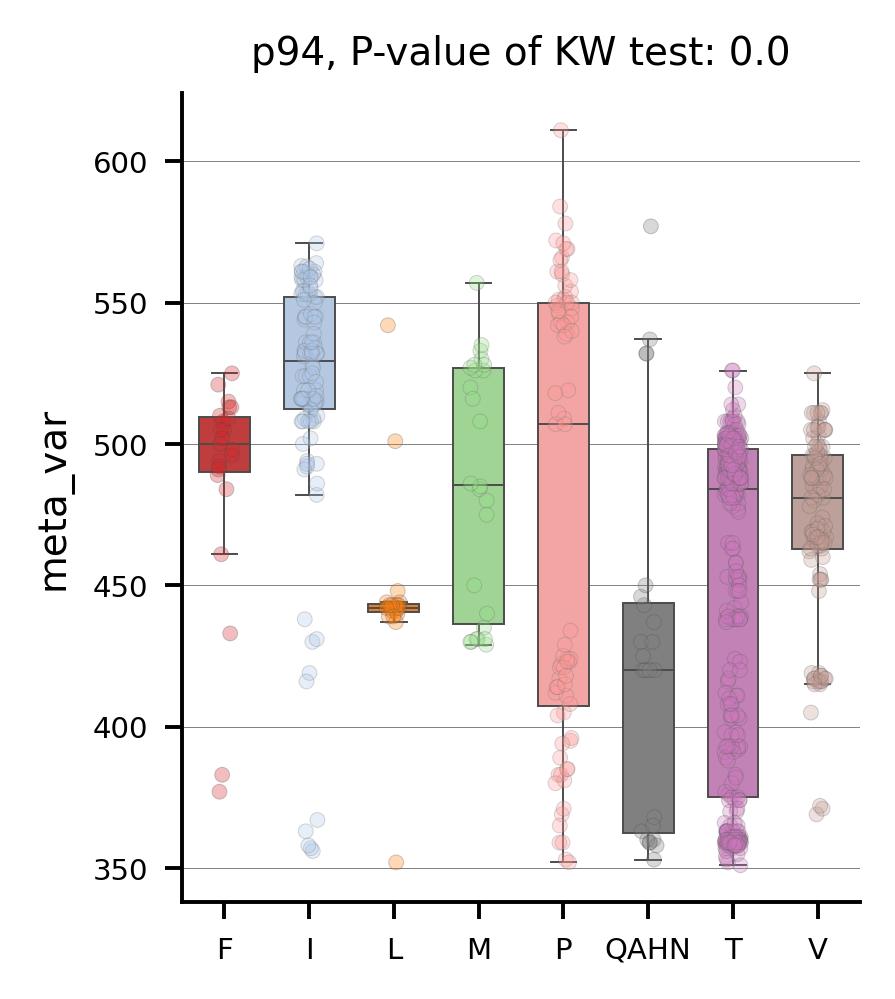

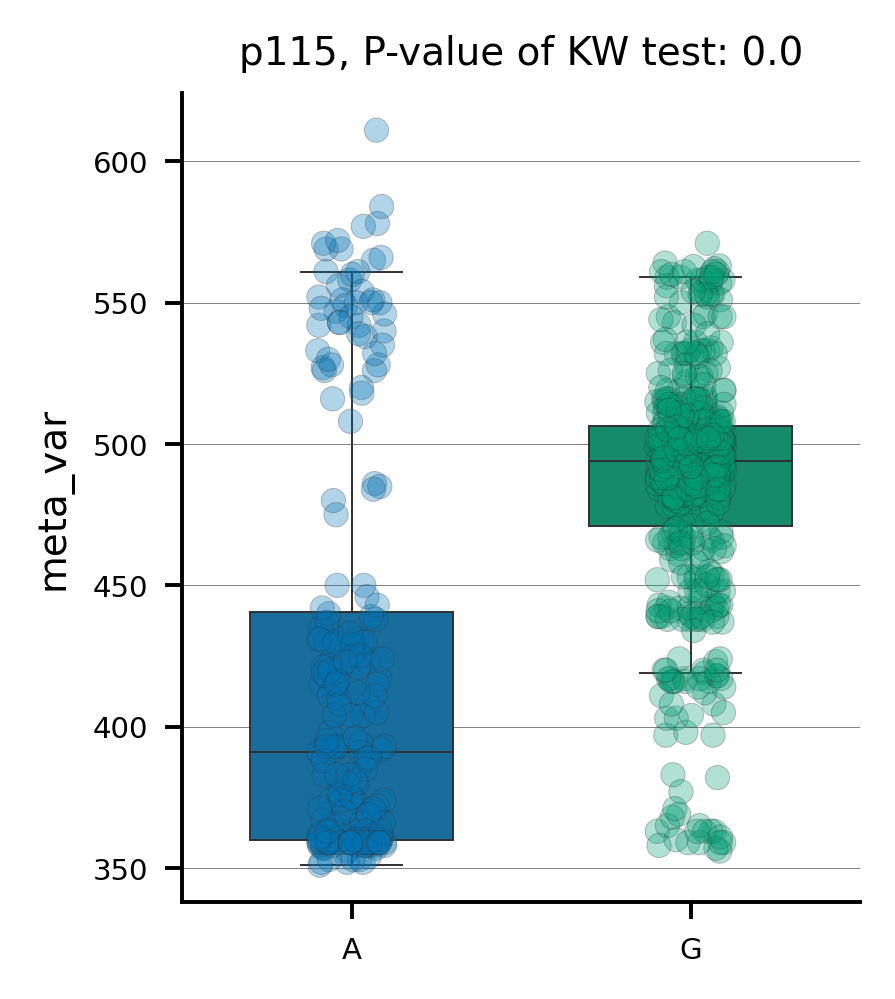

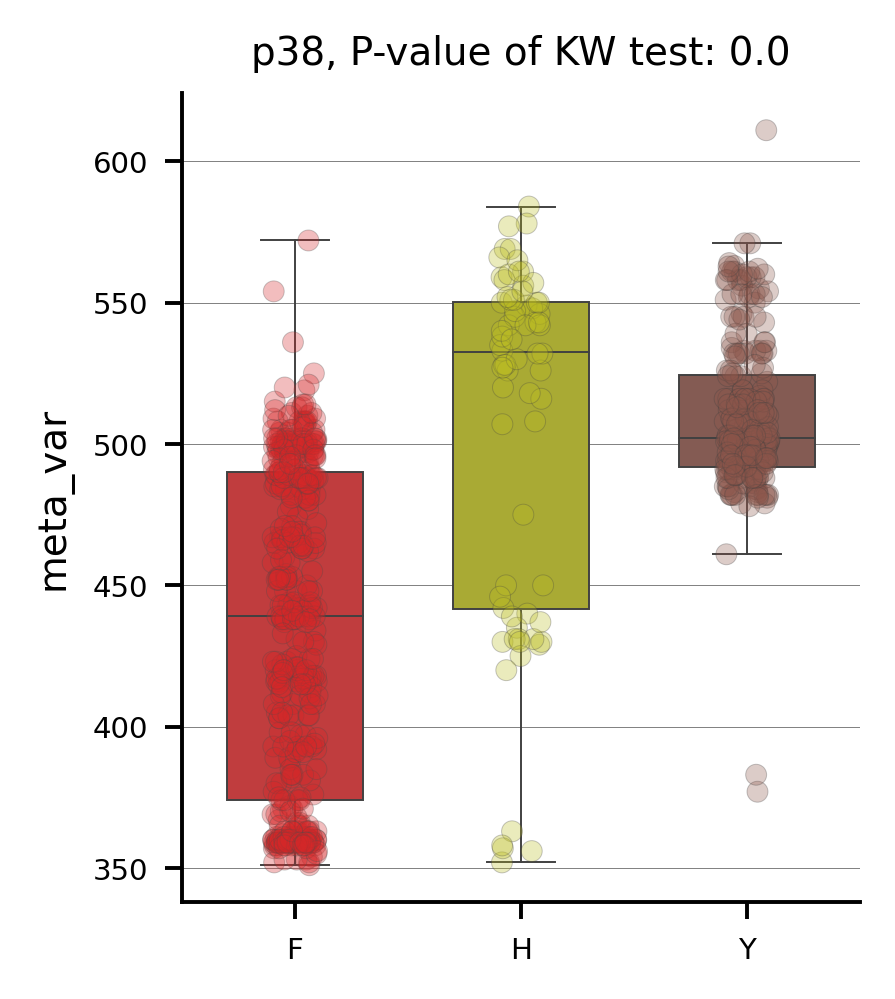

...

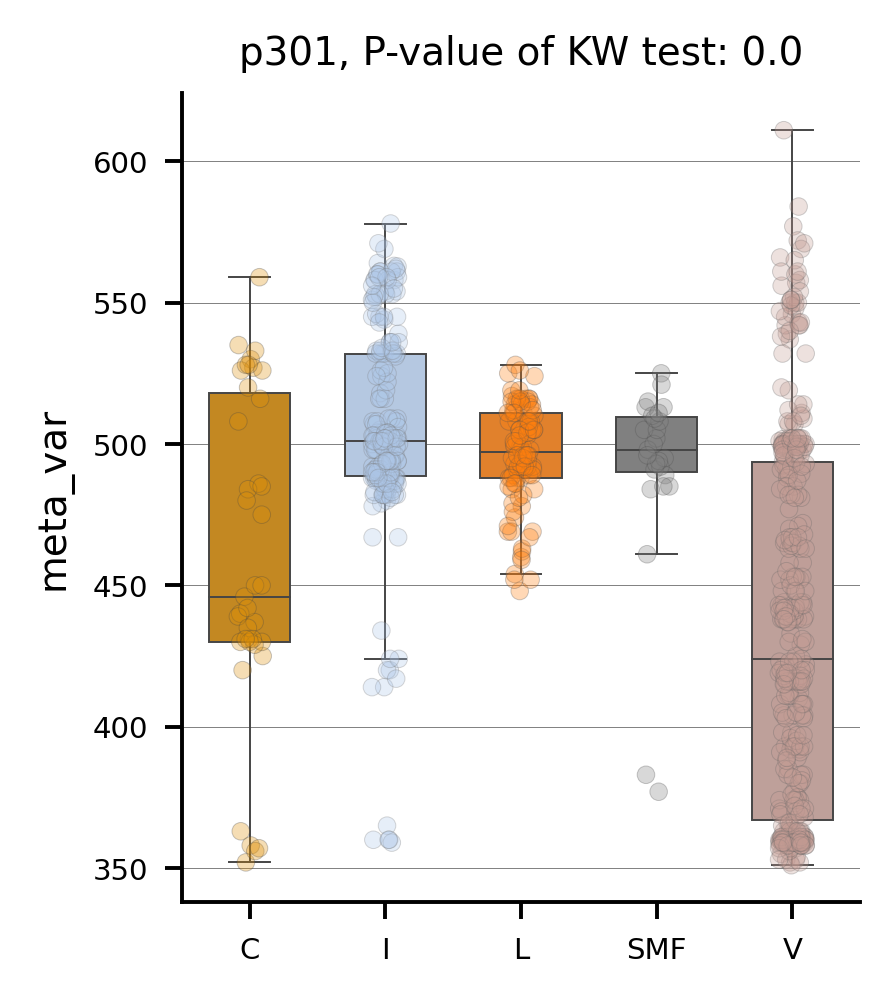

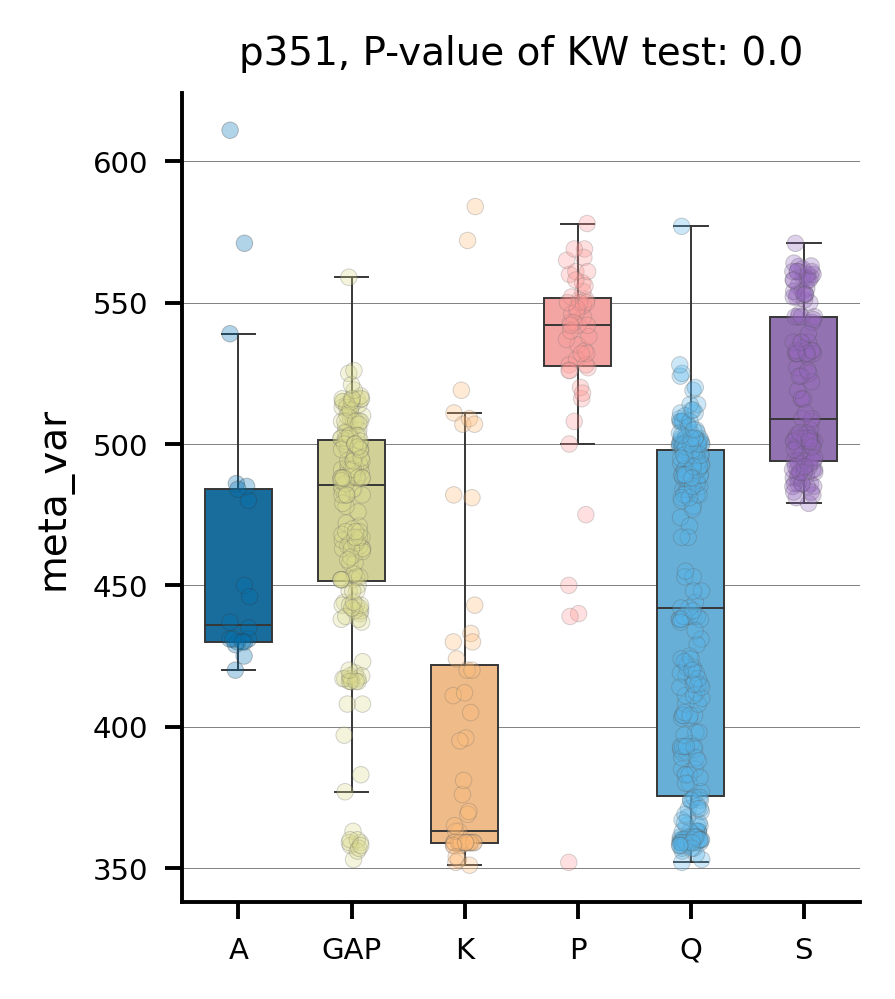

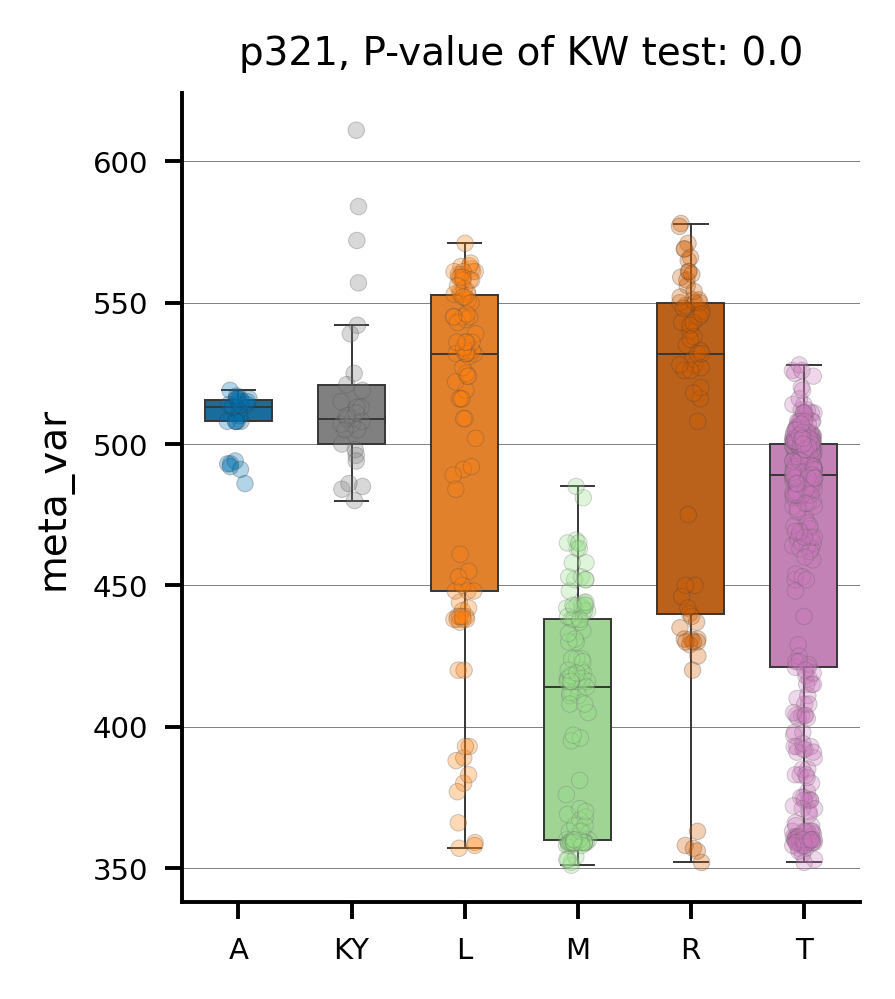

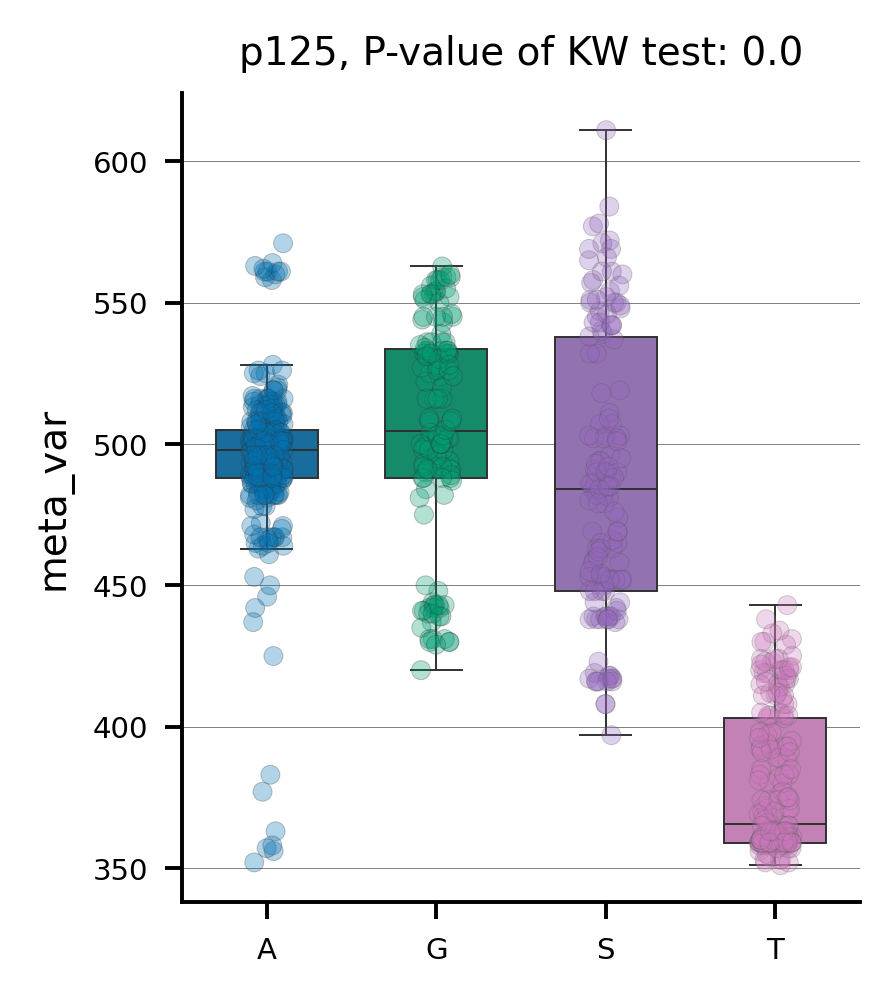

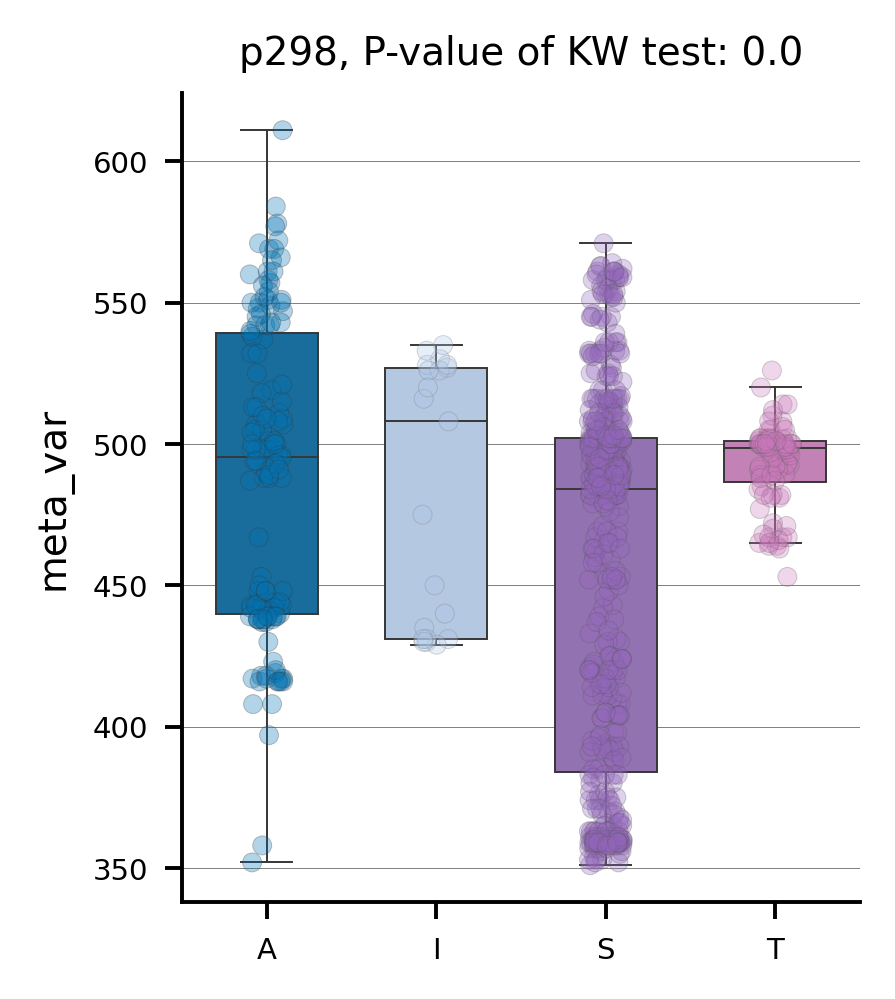

In [73]:
pl = plot_imp_all(final_models=top,
                  X_train=tr, y_train=y,
                  model_type = ana_type,
                  report_dir=report_dir, max_plots=100,
                  figsize=(2.5, 3))

In [74]:
from deepBreaks.utils import load_obj
import joblib
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
load_rf = load_obj(f'{report_dir}/lgbm.pkl')

In [75]:
print(f'Here is a list of your top performing models to test...\n{top_model_list}')

Here is a list of your top performing models to test...
['wds_aligned_db_fmt_mutant_aligned_Lambda_Max_2023-08-08_18-29-19', 'wds_aligned_db_fmt_mutant_aligned_Lambda_Max_2023-08-08_18-29-19', 'wds_aligned_db_fmt_mutant_aligned_Lambda_Max_2023-08-08_18-29-19']


In [76]:
predictions = load_rf.predict(unseen)
print(predictions)


[456.2930222  406.90790045 499.37527933 499.63655518 467.7018025
 356.11966572 517.07541618 415.01850846 435.28307016 501.63560863
 497.53772524 377.026951   503.5742612  407.68789246 542.45010278
 468.13617406 532.43192735 359.51240499 365.42132106 505.57485671
 367.85045575 371.3351861  521.19632722 463.15592832 501.58745611
 497.13227665 355.2173539  489.97302266 366.50762524 507.68328945
 418.64012225 347.71785658 547.26417425 502.56934623 543.85901315
 487.87405126 559.5533549  369.47981361 564.17804342 373.98867567
 401.15594254 383.01385612 535.11018981 515.05406558 405.31962789
 423.02589543 446.34900413 511.67602236 409.19607243 431.59746662
 382.48997548 493.73211638 483.45334249 493.5712955  501.93615523
 357.42914471 395.8995156  404.20162346 504.64884129 498.66087448
 483.45334249 445.52447819 494.82510697 529.07963181 538.22579717
 507.91947599 362.0330085  499.55861768 442.27709312 443.84832979
 529.246014   391.72591337 360.67262276 529.71881372 418.00216981
 489.139604

In [77]:
base_test['Prediction'] = predictions
base_test['Difference'] = base_test['Prediction'] - base_test['Lambda_Max']
base_test = base_test[['Species', 'Opsin_Family', 'Accession','Lambda_Max','Prediction','Difference']]

base_test.to_csv(path_or_buf= f'{report_dir}/basetest_results.csv',index = 'Feature',mode="w")

base_test.head()

,Species,Opsin_Family,Accession,Lambda_Max,Prediction,Difference
S472,Oryzias_luzonensis,Rh2,LC260048,447.0,456.293022,9.293022
S397,Gallus_gallus,SWS1,NM_205438.1_V116L,419.0,406.907900,-12.092100
S12,Altolamprologus_calvus,Rh1,AB458132.1,498.0,499.375279,1.375279
S32,Pseudotropheus_sp.,Rh1,GQ422475.1,498.0,499.636555,1.636555
S168,Gekko_gekko,Rh2,M92035_A164S,467.0,467.701803,0.701803


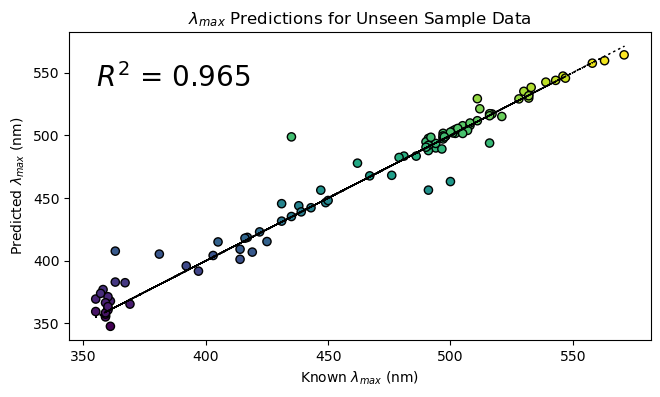

<Figure size 750x400 with 0 Axes>

In [78]:
plt.rcParams["figure.figsize"] = [7.50, 4.00]
plt.title("$λ_{max}$ Predictions for Unseen Sample Data")
plt.scatter(umd, predictions, c=predictions, ec = 'k', edgecolors='k', s = 35)
plt.plot(umd, umd, c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(unseen, umd):.3f}",(min(umd), (max(umd) - ((max(umd) - min(umd)) *  0.15))), fontsize = 20, c = 'k')
#plt.xticks(range(min(umd), max(umd)+1))
fileout = f'{report_dir}/hetero_dp2.pdf'
plt.savefig(fileout)
plt.show()
plt.clf()
plt.show()


In [79]:
model_testing__report = f'{report_dir}/model_testing report.tsv'

base_rsq = load_rf.score(unseen, umd)
print(base_rsq)

base_mae = mean_absolute_error(predictions,umd)
print(base_mae)

base_mape = mean_absolute_percentage_error(predictions,umd)
print(base_mape)

base_sqe = mean_squared_error(predictions,umd)
print(base_sqe)

base_rsqe = mean_squared_error(predictions,umd, squared = False)
print(base_rsqe)

with open(model_testing__report , 'w') as f:
    f.write(f'Base Model R^2\tBase Model MAE\tBase Model MAPE\tBase Model SQE\tBase Model RSQE\n')
    f.write(f'{str(base_rsq)}\t{str(base_mae)}\t{str(base_mape)}\t{str(base_sqe)}\t{str(base_rsqe)}')




0.964718137687531
6.516534676871114
0.014846566496873867
138.40037651248235
11.764368938131886


In [80]:
msp_predictions = load_rf.predict(msp)
print(msp_predictions)

[517.27465921 422.39602174 534.74754834 449.56055218 415.69387448
 483.45334249 505.1798801  413.97328937 404.80924109 437.91951088
 529.20019067 399.02810701 472.7962033  464.1315291  551.89855639
 466.92883322 446.56767549 531.61559386 421.05699787 526.61717083
 456.20194426 408.30868737 520.63987459 534.25493985 443.32133974
 428.1018722  536.16686563 443.12380815 401.07238475 545.26856411
 443.94503664 431.44824152 441.41428427 428.04863061 444.97893178
 499.05260875 498.81229414 499.2106005  498.81229414 498.81229414
 498.81229414 499.0554944  498.50749431 498.80105065 498.81229414
 498.81229414 498.81229414 499.08559629 498.49625082 498.78079646
 498.78079646 498.78079646 498.78079646 498.75069457 498.49625082
 498.80105065 498.81229414 498.81229414 499.08559629 499.0554944
 499.0554944  499.0554944  498.75069457 498.75069457 498.75069457
 498.50749431 498.78079646 498.78079646 498.49625082 498.80105065]


In [81]:
meta = "./msp_test_data/erg_msp_meta.tsv"
msp_meta = pd.read_csv(meta, sep="\t", index_col = False)
msp_meta.head()

,Species,Accession,Lambda_Max
0,Neogonodactylus_oerstedii,KJ127520.1,334
1,Neogonodactylus_oerstedii,KJ127521.1,383
2,Bombus_impatiens,XP_012237087.1,539
3,Bombus_impatiens,XP_003494923.1,424
4,Bombus_impatiens,AAV67326.1,347


In [82]:
lmax_msp = (msp_meta['Lambda_Max'])
lm = []
for i in lmax_msp:
    lm.append(float(i))


In [83]:
columns = ['Species','Accession','Lambda_Max','Predicted','Differnce']
msp_test = pd.DataFrame(index=msp.index, columns = columns)
msp_test['Predicted'] = msp_predictions
msp_test['Species'][0:31] = msp_meta['Species']
msp_test['Accession'][0:31] = msp_meta['Accession']

msp_test.head()

,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,NaN,517.274659,NaN
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,NaN,422.396022,NaN
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,NaN,534.747548,NaN
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,NaN,449.560552,NaN
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,NaN,415.693874,NaN


In [84]:

msp_test['Lambda_Max'][0:31] = lm
msp_test['Differnce'] = msp_test['Predicted'] - msp_test['Lambda_Max']
msp_test.head()


,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,334.0,517.274659,183.274659
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,383.0,422.396022,39.396022
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,539.0,534.747548,-4.252452
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,424.0,449.560552,25.560552
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,347.0,415.693874,68.693874


In [85]:
msp_test.to_csv(path_or_buf= f'{report_dir}/msp_test_results.csv',index = 'Feature',mode="w")

In [86]:
mae = mean_absolute_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31])
print(mae)
msp_rsq = load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31])
print(msp_rsq)


36.36928660619118


0.4835841481166734


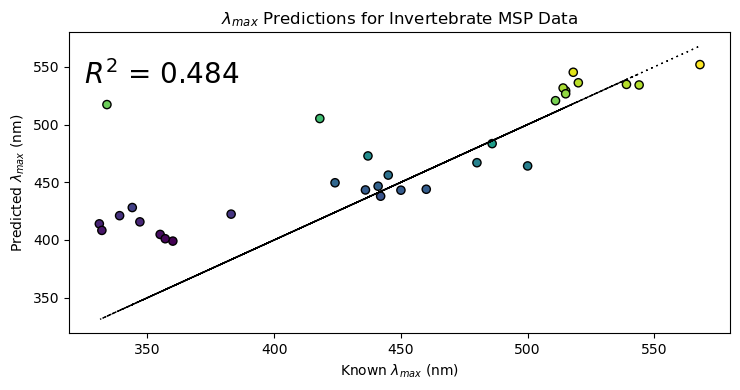

In [87]:
plt.rcParams["figure.autolayout"] = True
plt.rcParams["figure.figsize"] = [7.50, 4.00]
plt.title("$λ_{max}$ Predictions for Invertebrate MSP Data")
plt.scatter(msp_test['Lambda_Max'][0:31], msp_predictions[0:31], c=msp_predictions[0:31], ec = 'k', edgecolors='k', s = 35)
plt.plot(msp_test['Lambda_Max'][0:31], msp_test['Lambda_Max'][0:31], c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31]):.3f}",(325, 535), fontsize = 20, c = 'k')
fileout = f'{report_dir}/msp_dp.pdf'
plt.savefig(fileout)
plt.show()

In [88]:
msp_rsq = load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31])
#print(msp_rsq)
msp_mae = mean_absolute_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31])
#print(msp_mae)
msp_mape = mean_absolute_percentage_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31])
#print(msp_mape)
msp_sqe = mean_squared_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31])
#print(msp_sqe)
msp_rsqe = mean_squared_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31], squared = False)
#print(msp_rsqe)
with open(model_testing__report , 'a') as f:
    f.write(f'\nMSP Model Test R^2\tMAE\tMAPE\tSQE\tRSQE\n')
    f.write(f'{str(msp_rsq)}\t{str(msp_mae)}\t{str(msp_mape)}\t{str(msp_sqe)}\t{str(msp_rsqe)}')


Below is just a way for me to properly format test data for previously trained models using the base training data... 

# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
import warnings
import datetime
import os
import numpy as np
import csv
import pandas as pd

# defining user params, file pathes, analysis type

# path to sequences
seqFileName = 'wds_fmt_msp.fasta' 

# path to metadata
metaDataFileName = 'wds_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 

# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('.')[0]
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)

# importing sequences data
print('reading fasta file')
tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)

#start here with removing the bottom ~25 sequences 
msp = tr.iloc[856:].copy()
msp.head()

tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

sample_n = 50
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1

unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)

y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)


# <font color=red>STEP 4: Translate Candidate STSs</font> 
## Optional step IF running the classifier model, but could still be useful.
### To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
### Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.

In [89]:
import pandas as pd
import os

In [90]:
#STEP 4: Translate Candidate STSs 
#Optional step IF running the classifier model, but could still be useful.
#To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
#Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.
m = 0
tm = ''
k=0
gaps=0
#import importance_report.csv from report_dir
true_pos = []
aa = []
tmd = []

df = pd.read_csv(f'{report_dir}\importance_report.csv')

#take the list of important sites and translate them to the bovine standard equivalent, we do this by taking the site number and subtracting the number of '-' between the start of the sequence and the desired site. 
for rows in bovine.values:  
    rows = str(rows)
    #print(rows)
    if rows == 'nan':
    #We want to write the 'true_pos', 'aa', and 'TMD' to the 'importance_report' csv file
        gaps += 1
        k += 1
        true_pos.append('NA')
        aa.append('-')
        tmd.append('NA')
    else:
        #print("The number of gaps is " + str(gaps))
        k+=1
        trans_site = k - gaps

        if trans_site in range(39,66):
            tm = '1'
        elif trans_site in range(3,38):
            tm = 'N-Termina'
        elif trans_site in range(72,100):
            tm = '2'
        elif trans_site in range(110,141):
            tm = '3'
        elif trans_site in range(151,174):
            tm = '4'
        elif trans_site in range(200,231):
            tm = '5'
        elif trans_site in range(245,276):
            tm = '6'
        elif trans_site in range(285,311):
            tm = '7'
        else:
            tm = 'NA'
        
        true_pos.append(str(trans_site))
        aa.append(rows)
        tmd.append(tm)
true_pos.pop()
aa.pop()
tmd.pop()

df['true_position'] = true_pos
df['TMD'] = tmd
df['amino_acid'] = aa

df.to_csv(path_or_buf= os.path.join(report_dir,r'importance_report.csv'),index = 'Feature',mode="w")
df.head()


,feature,lgbm,BayesianRidge,gbc,mean,true_position,TMD,amino_acid
0,1,0.019231,0.032885,0.000119,0.017412,1,NA,M
1,2,0.015385,0.188748,0.040849,0.081661,2,NA,N
2,3,0.000000,0.029131,0.001036,0.010055,3,N-Termina,G
3,4,0.023077,0.117700,0.002748,0.047842,4,N-Termina,T
4,5,0.010256,0.092907,0.008677,0.037280,5,N-Termina,E
